# <center><font color='#3b4859'><u><b>Projet de deep learning : face mask identification</b></u></font></center>

# <font color='#3b4859'>Le contexte</font>

Pour ce projet,
vous vous glisserez dans la peau d’un Data Scientist travaillant pour PARIS AEROPORT
sur les systèmes de reconnaissance faciale.

Votre équipe est au centre de la BU Analytics chargée notamment de mettre en place le
nouveau système de reconnaissance faciale afin de faciliter l’enregistrement et
l’embarquement des passagers.
Lors des réunions pour cadrer le projet, votre manager vous demande de construire un
premier modèle sur la détection du port de masque. L’objectif étant de s’assurer que les
passagers n’aient pas oublié de retirer leur masque avant de se présenter devant les
portiques automatiques et les automates.

# <font color='#3b4859'>1. Import des librairies et des données</font>

## <font color='#3b4859'>1.1 Import des librairies</font>


In [1]:
# Import des packages de pytorch
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.autograd import Variable

# Package pytorch pour réaliser de la computer vision
import torchvision
from torch.utils.data import Dataset
from torchvision import datasets, transforms

# Représentation graphique
import matplotlib.pyplot as plt

# Manipulation des données
import numpy as np
from PIL import Image

# Split de données
from sklearn.model_selection import train_test_split

# Activation des calculs sur GPU
device = torch.device("cuda") if torch.cuda.is_available else "cpu"
device

device(type='cuda')

## <font color='#3b4859'>1.2 Import des données</font>

Importons le jeu de données issu de *kaggle*

https://www.kaggle.com/datasets/dhruvmak/face-mask-detection

In [2]:
# ******** Notes pour la bonne execution du notebook ********

# Rendez vous sur la page web des réglages de kaggle
# https://www.kaggle.com/settings
# Créez un nouveau token
# Uploadez le fichier kaggle.json dans le notebook

! pip install -q kaggle
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json
! kaggle datasets list

ref                                                           title                                          size  lastUpdated          downloadCount  voteCount  usabilityRating  
------------------------------------------------------------  --------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
nelgiriyewithana/top-spotify-songs-2023                       Most Streamed Spotify Songs 2023               47KB  2023-08-26 11:04:57          14595        458  1.0              
joebeachcapital/students-performance                          Students Performance                            2KB  2023-08-31 00:50:11           5093        136  1.0              
carlmcbrideellis/zzzs-lightweight-training-dataset-target     Zzzs: Lightweight training dataset + target   185MB  2023-09-20 19:52:40            536         74  1.0              
iamsouravbanerjee/airline-dataset                             Airline Dataset                       

In [3]:
# Téléchargement des données
! kaggle datasets download dhruvmak/face-mask-detection

 94% 182M/194M [00:00<00:00, 197MB/s]
100% 194M/194M [00:01<00:00, 195MB/s]


In [4]:
!unzip face-mask-detection.zip

Archive:  face-mask-detection.zip
  inflating: dataset/with_mask/image_0.png  
  inflating: dataset/with_mask/image_1.png  
  inflating: dataset/with_mask/image_10.png  
  inflating: dataset/with_mask/image_100.png  
  inflating: dataset/with_mask/image_101.png  
  inflating: dataset/with_mask/image_102.png  
  inflating: dataset/with_mask/image_103.png  
  inflating: dataset/with_mask/image_104.png  
  inflating: dataset/with_mask/image_105.png  
  inflating: dataset/with_mask/image_106.png  
  inflating: dataset/with_mask/image_107.png  
  inflating: dataset/with_mask/image_108.png  
  inflating: dataset/with_mask/image_109.png  
  inflating: dataset/with_mask/image_11.png  
  inflating: dataset/with_mask/image_110.png  
  inflating: dataset/with_mask/image_111.png  
  inflating: dataset/with_mask/image_112.png  
  inflating: dataset/with_mask/image_113.png  
  inflating: dataset/with_mask/image_114.png  
  inflating: dataset/with_mask/image_115.png  
  inflating: dataset/with_mask/i

In [5]:
# Vérifions la présence du dossier désarchivé
!ls

dataset  face-mask-detection.zip  kaggle.json  sample_data


Le jeu de données est bien présent dans le dossier *dataset*.

## <font color='#3b4859'>1.3 Choix du modèle et import</font>

Nous allons sélectionner un modèle de classification avec des poids pré-entrainés.

Ceux-ci sont disponibles avec la librairie Pytorch.

Lien vers la documentation :
https://pytorch.org/vision/stable/models.html#table-of-all-available-classification-weights

Sur la base de la documentation, deux modèles se démarquent par leurs performances prédictives sur le dataset **ImageNet-1K**.

[ImageNet](https://www.image-net.org/index.php)


1.   **VIT_B_16**, un réseau de neurones "vision transformer" entraîné avec la méthode SWAG (Supervised Weakly through hashtAGs).

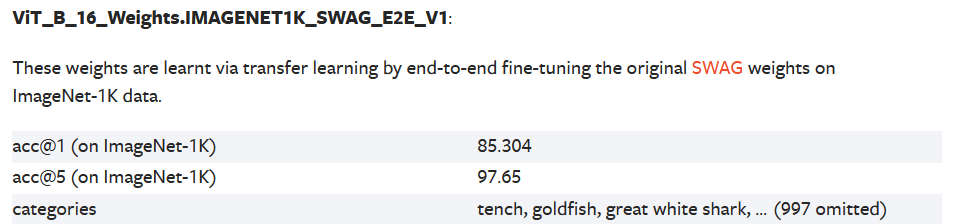

2.   Le modèle **RegNet_Y_32GF**, réseau de neurones basé sur des blocs de convolution, également entraîné avec la méthode SWAG.

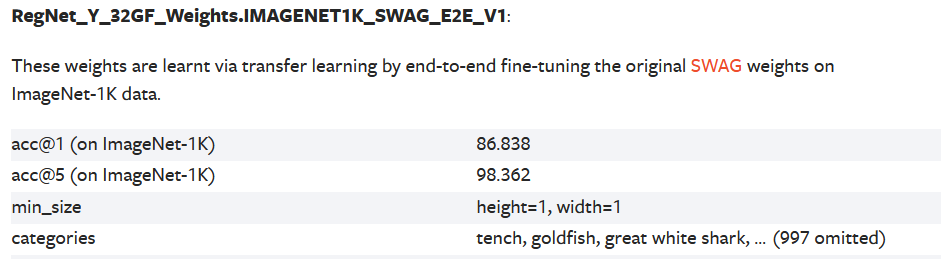


### <font color='#3b4859'>1.3.1 Import du ViT et des poids</font>

In [6]:
from torchvision.models import vit_b_16, ViT_B_16_Weights

weights = ViT_B_16_Weights.IMAGENET1K_SWAG_E2E_V1
vit_model = vit_b_16(weights=weights)
vit_model


Downloading: "https://download.pytorch.org/models/vit_b_16_swag-9ac1b537.pth" to /root/.cache/torch/hub/checkpoints/vit_b_16_swag-9ac1b537.pth
100%|██████████| 331M/331M [00:05<00:00, 63.4MB/s]


VisionTransformer(
  (conv_proj): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
  (encoder): Encoder(
    (dropout): Dropout(p=0.0, inplace=False)
    (layers): Sequential(
      (encoder_layer_0): EncoderBlock(
        (ln_1): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (self_attention): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
        )
        (dropout): Dropout(p=0.0, inplace=False)
        (ln_2): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (mlp): MLPBlock(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU(approximate='none')
          (2): Dropout(p=0.0, inplace=False)
          (3): Linear(in_features=3072, out_features=768, bias=True)
          (4): Dropout(p=0.0, inplace=False)
        )
      )
      (encoder_layer_1): EncoderBlock(
        (ln_1): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (self_a

In [7]:
# Iterating the items of the meta-data dictionary
for k, v in ViT_B_16_Weights.IMAGENET1K_SWAG_E2E_V1.meta.items():
    print(k, v)

categories ['tench', 'goldfish', 'great white shark', 'tiger shark', 'hammerhead', 'electric ray', 'stingray', 'cock', 'hen', 'ostrich', 'brambling', 'goldfinch', 'house finch', 'junco', 'indigo bunting', 'robin', 'bulbul', 'jay', 'magpie', 'chickadee', 'water ouzel', 'kite', 'bald eagle', 'vulture', 'great grey owl', 'European fire salamander', 'common newt', 'eft', 'spotted salamander', 'axolotl', 'bullfrog', 'tree frog', 'tailed frog', 'loggerhead', 'leatherback turtle', 'mud turtle', 'terrapin', 'box turtle', 'banded gecko', 'common iguana', 'American chameleon', 'whiptail', 'agama', 'frilled lizard', 'alligator lizard', 'Gila monster', 'green lizard', 'African chameleon', 'Komodo dragon', 'African crocodile', 'American alligator', 'triceratops', 'thunder snake', 'ringneck snake', 'hognose snake', 'green snake', 'king snake', 'garter snake', 'water snake', 'vine snake', 'night snake', 'boa constrictor', 'rock python', 'Indian cobra', 'green mamba', 'sea snake', 'horned viper', 'dia

In [8]:
# Affichons les transformations d'inférence
preprocess = weights.transforms()
preprocess

ImageClassification(
    crop_size=[384]
    resize_size=[384]
    mean=[0.485, 0.456, 0.406]
    std=[0.229, 0.224, 0.225]
    interpolation=InterpolationMode.BICUBIC
)

### <font color='#3b4859'>1.3.2 Import du RegNet et des poids.</font>

In [9]:
from torchvision.models import regnet_y_32gf, RegNet_Y_32GF_Weights

regnet_weights = RegNet_Y_32GF_Weights.IMAGENET1K_SWAG_E2E_V1
regnet_model = regnet_y_32gf(weights=regnet_weights)
regnet_model

Downloading: "https://download.pytorch.org/models/regnet_y_32gf_swag-04fdfa75.pth" to /root/.cache/torch/hub/checkpoints/regnet_y_32gf_swag-04fdfa75.pth
100%|██████████| 554M/554M [00:09<00:00, 63.7MB/s]


RegNet(
  (stem): SimpleStemIN(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
  )
  (trunk_output): Sequential(
    (block1): AnyStage(
      (block1-0): ResBottleneckBlock(
        (proj): Conv2dNormActivation(
          (0): Conv2d(32, 232, kernel_size=(1, 1), stride=(2, 2), bias=False)
          (1): BatchNorm2d(232, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        )
        (f): BottleneckTransform(
          (a): Conv2dNormActivation(
            (0): Conv2d(32, 232, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (1): BatchNorm2d(232, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): ReLU(inplace=True)
          )
          (b): Conv2dNormActivation(
            (0): Conv2d(232, 232, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
            (1):

In [10]:
# Iterating the items of the meta-data dictionary
for k, v in RegNet_Y_32GF_Weights.IMAGENET1K_SWAG_E2E_V1.meta.items():
    print(k, v)

min_size (1, 1)
categories ['tench', 'goldfish', 'great white shark', 'tiger shark', 'hammerhead', 'electric ray', 'stingray', 'cock', 'hen', 'ostrich', 'brambling', 'goldfinch', 'house finch', 'junco', 'indigo bunting', 'robin', 'bulbul', 'jay', 'magpie', 'chickadee', 'water ouzel', 'kite', 'bald eagle', 'vulture', 'great grey owl', 'European fire salamander', 'common newt', 'eft', 'spotted salamander', 'axolotl', 'bullfrog', 'tree frog', 'tailed frog', 'loggerhead', 'leatherback turtle', 'mud turtle', 'terrapin', 'box turtle', 'banded gecko', 'common iguana', 'American chameleon', 'whiptail', 'agama', 'frilled lizard', 'alligator lizard', 'Gila monster', 'green lizard', 'African chameleon', 'Komodo dragon', 'African crocodile', 'American alligator', 'triceratops', 'thunder snake', 'ringneck snake', 'hognose snake', 'green snake', 'king snake', 'garter snake', 'water snake', 'vine snake', 'night snake', 'boa constrictor', 'rock python', 'Indian cobra', 'green mamba', 'sea snake', 'hor

In [11]:
preprocess = regnet_weights.transforms()
preprocess

ImageClassification(
    crop_size=[384]
    resize_size=[384]
    mean=[0.485, 0.456, 0.406]
    std=[0.229, 0.224, 0.225]
    interpolation=InterpolationMode.BICUBIC
)

# <font color='#3b4859'>2. Préparation des données</font>

Maintenant que nous avons nos données en local, nous allons construire une classe de Dataset utilisant pytorch et torchvision.

Dans un premier temps nous allons renommer les fichiers d'images contenus dans le dossier dataset

*   `dataset/with_mask/`
*   `dataset/without_mask/`

Ceci va nous permettre d'accèder plus facilement aux
chemins d'images tout en ayant la possibilté de discréminer le type d'image (avec ou sans masque). Ce qui nous sera utile dans la suite du projet pour savoir si il s'agit d'une personne portant un masque ou non.

In [12]:
# import du module permettant d'utiliser les fonctionnalités dépendantes du système d'exploitation
import os
mask_folder = "./dataset/with_mask/"
no_mask_folder = "./dataset/without_mask/"


def image_renaming(img_folder):
  '''
  Fonction de retraitement des chemins d'accès
  L'argument est le chemin d'accès aux fichier d'image
  '''
  mask = "with_mask_"
  without_mask = "without_mask_"
  count = 1

  for file_name in os.listdir(img_folder):
      # Chemin à modifier
      old_name = img_folder + file_name

      if img_folder == "./dataset/with_mask/":
        new_name = img_folder + mask + file_name
      else:
        new_name = img_folder + without_mask + file_name

      # Modification du chemin
      os.rename(old_name, new_name)
      count += 1
  print(f'Fichiers images du répertoire {img_folder} renommés:')

  print('Voici les nouveaux noms:')

  # vérifions le résultat
  res = os.listdir(img_folder)
  print(res)

In [13]:
image_renaming(mask_folder)
image_renaming(no_mask_folder)

Fichiers images du répertoire ./dataset/with_mask/ renommés:
Voici les nouveaux noms:
['with_mask_image_189.png', 'with_mask_image_21.png', 'with_mask_image_151.png', 'with_mask_image_125.png', 'with_mask_image_49.png', 'with_mask_image_200.png', 'with_mask_image_217.png', 'with_mask_image_179.png', 'with_mask_image_79.png', 'with_mask_image_205.png', 'with_mask_image_112.png', 'with_mask_image_215.png', 'with_mask_image_19.png', 'with_mask_image_129.png', 'with_mask_image_70.png', 'with_mask_image_155.png', 'with_mask_image_170.png', 'with_mask_image_80.png', 'with_mask_image_185.png', 'with_mask_image_162.png', 'with_mask_image_194.png', 'with_mask_image_68.png', 'with_mask_image_30.png', 'with_mask_image_61.png', 'with_mask_image_8.png', 'with_mask_image_95.png', 'with_mask_image_60.png', 'with_mask_image_11.png', 'with_mask_image_157.png', 'with_mask_image_44.png', 'with_mask_image_1.png', 'with_mask_image_132.png', 'with_mask_image_62.png', 'with_mask_image_89.png', 'with_mask_ima

Affichons une image et vérifions dans le même temps l'accès aux données.

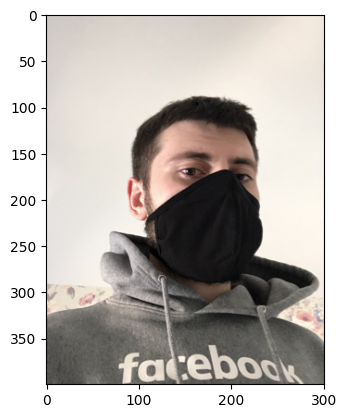

Shape de l'array : (400, 301, 4)


In [14]:
image_list = os.listdir(mask_folder)

# Lecture de l'image en numpy array
img = np.asarray(Image.open(f"./dataset/with_mask/{image_list[0]}"))

# Visualisation de l'image
plt.imshow(img)
plt.show()

# Afficher les dimensions de l'image
print("Shape de l'array : " + str(img.shape))

Nous constatons que l'image a 4 dimensions, hors nous souhaitons travailler avec des images en 3 dimensions ce qui correspond au format RGB.

## <font color='#3b4859'>2.1 Création du Dataset</font>

Nous créons ici une classe de dataset custom pour associer à chaque image un label.



*   Avec masque = 1
*   Sans masque = 0

Les images sont aussi converties au format RGB [3, H, W].



In [15]:
import pandas as pd
from torchvision.io import read_image
import torchvision.transforms as T
from torchvision.transforms.functional import InterpolationMode



class ImageDataset(Dataset):
    def __init__(self, img_dir, transform=None):
        self.images = img_dir
        self.labels = [0 if "without" in img_name.lower() else 1 for img_name in self.images]
        self.transform = transform

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        # Permet d'obtenir le label de l'image
        label = self.labels[idx]
        image = Image.open(img_path).convert('RGB')

        if self.transform:
            image = self.transform(image)

        return image, label

## <font color='#3b4859'>2.2 Transformation et augmentation des données</font>

Ensuite, définissons les transformations d'images pour l'inférence du modèle, avec les bonnes valeurs d'entrées.

L'augmentation des données d'images est pour l'instant réalisée par une méthode d'auto-augmentation.

In [16]:
# redimensionnement des images en 384x384 pixels et interpolation
# recadrage central
# conversion en tenseurs PyTorch
# normalisation des valeurs de pixel

data_transform = T.Compose([
    transforms.Resize(384, InterpolationMode.BICUBIC),
    transforms.CenterCrop(384),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Augmentation des données :
# Inversion horizontale aléatoire
# Inversion verticale aléatoire
# Rotation aléatoire
# Perturbations légères à la couleur de l'image
# Inversion de couleur
# Nuances de gris

data_augmentation = T.Compose([
    transforms.Resize(384, InterpolationMode.BICUBIC),
    transforms.CenterCrop(384),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomVerticalFlip(p=0.25),
    transforms.RandomRotation(degrees=20),
    transforms.RandomInvert(p=0.25),
    transforms.RandomGrayscale(p=0.25),
    transforms.ColorJitter(brightness=0.05, contrast=0.05, saturation=0.05, hue=0.05),
])

## <font color='#3b4859'>2.3 Division des données</font>


Nous allons maintenant diviser les données en échantillons d'entraînement, de validation et de test.

*   70% pour le train
*   20% pour la validation
*   10% pour le test



La data augmentation sera ainsi appliquée uniquement sur l'échantillon d'entraînement.

In [17]:
# récupérons les chemins d'accès aux images et stockons les dans une liste
mask_images_list = os.listdir(mask_folder)
no_mask_images_list = os.listdir(no_mask_folder)

all_image_paths = []
for i in range(len(mask_images_list)):
  all_image_paths.append(str(mask_folder)+mask_images_list[i])
for j in range(len(no_mask_images_list)):
  all_image_paths.append(str(no_mask_folder)+no_mask_images_list[j])


# Divisons premièrement le jeu de données en ensemble d'entraînement et de test
train_paths, test_paths = train_test_split(all_image_paths, test_size=0.3, random_state=42)

print(f"Nous obtenons dans un premier temps:\n- un train de {len(train_paths)} chemins d'images\n- un échantillons de test de {len(test_paths)} chemins\n- {len(train_paths)+len(test_paths)} chemins au total.")

Nous obtenons dans un premier temps:
- un train de 308 chemins d'images
- un échantillons de test de 132 chemins
- 440 chemins au total.


In [18]:
# dans un second temps construisons les datasets
train_dataset = ImageDataset(img_dir=train_paths, transform=data_augmentation)
test_dataset = ImageDataset(img_dir=test_paths, transform=data_transform)

Affichons une image augmentée issue du `train_dataset`.

L'image du dataset est bien affichée. Le label associé est : 1


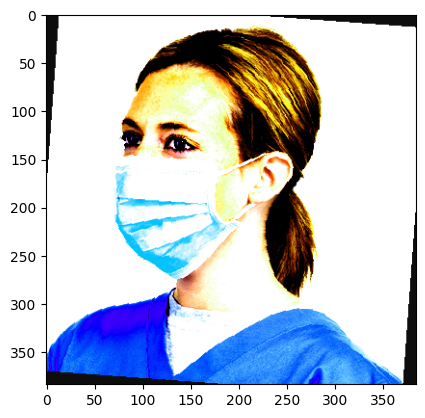

In [19]:
image, label = train_dataset[0]
print(f"L'image du dataset est bien affichée. Le label associé est : {label}")

# Lecture de l'image en numpy array
plot_image = image.numpy()
image = np.transpose(plot_image, (1, 2, 0))
image = (image - image.min()) / (image.max() - image.min())

# Visualisation de l'image
plt.imshow(image)

In [20]:
# Ensuite divisons l'échantillon de test
full_size = len(train_dataset) + len(test_dataset)
val_size = int(0.2 * full_size)
test_size = len(test_dataset) - (val_size)
validation_dataset, test_dataset = torch.utils.data.random_split(test_dataset, (val_size, test_size))

print(f"La taille de l'échantillon de validation est de {len(validation_dataset)} images.")
print(f"La taille de celui de test est de {len(test_dataset)} images.")

La taille de l'échantillon de validation est de 88 images.
La taille de celui de test est de 44 images.


In [21]:
batch_size = 16

# Création des DataLoader de training et validation
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
validation_loader  = torch.utils.data.DataLoader(validation_dataset, batch_size=batch_size, shuffle=False, num_workers=0)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=0)

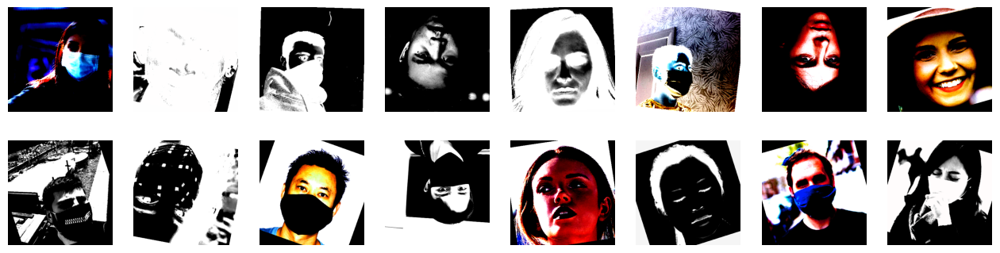

In [22]:
# affichons le premier batch des données augmentées
images, labels = next(iter(train_loader))

images_np = images.numpy()
plt.figure(figsize=(16,4))
n = len(images)
for i in range(n):

  plt.subplot(n // 8,8,i+1)
  plt.axis('off')
  image = np.transpose(images_np[i], (1, 2, 0))
  image = (image - image.min()) / (image.max() - image.min())
  plt.imshow(image)
  plt.axis("off")

# <font color='#3b4859'>3. Transfert Learning avec un Modèle Pré-entraîné</font>

## <font color='#3b4859'>3.1 Construction du modèle à partir de la dernière couche</font>

In [23]:
# Nombre de features en entrée de la dernière couche du modèle ViT
num_features = vit_model.heads.head.in_features

# Gèle de toutes les couches du modèle
for param in vit_model.parameters():
    param.requires_grad = False

# Modifions la dernière couche du modèle
vit_model.heads.head = nn.Linear(num_features, 1)
vit_model = vit_model.to(device)

param_entrainables = sum(p.numel() for p in vit_model.parameters() if p.requires_grad)
print(f"Le modèle a {param_entrainables} paramètres entraînables")

Le modèle a 769 paramètres entraînables


### <font color='#3b4859'> Choix de l'algorithme d'optimisation</font>

Le choix est justifié par les performances du modèle et sur la [documentation](https://arxiv.org/abs/2010.11929) le modèle est pré-entrainé avec Adam. " Training & Fine-tuning. We train all models, including ResNets, using Adam (Kingma & Ba,
2015) with β1 = 0.9, β2 = 0.999".

In [24]:
optimizer = torch.optim.Adam(vit_model.parameters(), weight_decay=0.1)

### <font color='#3b4859'> Choix de la fonction de perte</font>

Nous choisissons une fonction de perte adaptée à une classification binaire, la [BCEWithLogitsLoss](https://pytorch.org/docs/stable/generated/torch.nn.BCEWithLogitsLoss.html).

In [25]:
criterion = nn.BCEWithLogitsLoss()

## <font color='#3b4859'>3.2 &Eacute;tape d'entraînement</font>

Nous définissons ici la fonction `train` qui entraîne le modèle sur l'intégralité des batchs du dataset d'entrainement.

In [26]:
def train(model, optimizer, log_interval=200):
    # Passer le modèle en mode train
    model.train()

    # Boucler sur tous les batch du training set
    for batch_idx, (data, target) in enumerate(train_loader):
        # Passer les données sur GPU
        data = data.to(device)
        target = target.to(device)

        # Ré-initialiser les gradients
        optimizer.zero_grad()

        # Passer les données dans le réseau (forward propagation)
        output = model(data)

        # Calculer la loss
        loss = criterion(output, target.float().unsqueeze(1))

        # Backpropagation
        loss.backward()

        # Mise à jour des poids
        optimizer.step()

## <font color='#3b4859'>3.2 &Eacute;tape de validation</font>

Nous avons ensuite, la fonction `validate` qui entraîne le modèle sur l'intégralité du dataset de train ou de validation.

La fonction utilise `@torch.no_grad()` pour désactiver le calcul des gradients, puis calcule la perte moyenne (`val_loss`) et le nombre de prédictions correctes (`correct`) pour évaluer les performances du modèle sur un ensemble de données de validation ou de test.

De plus, en cas d'erreur sur les données d'entraînement les images seront affichées ce qui nous permettra de visualiser les mauvaises prédiction.

Dans le cas des données de test, nous aurons l'affichage des images, des étiquettes et des prédictions.

In [27]:
@torch.no_grad()
def validate(model, loader, loss_vector, accuracy_vector, step="Validation"):

    # Passer le modèle en mode eval
    model.eval()
    # Initialiser les valeurs de loss et de prediction correctes
    val_loss, correct =  0, 0

    # valeurs de retour pour afficher les résultats
    pred_list = []
    target_list = []
    data_list = []
    error_list = []

    # Boucler sur tous les batch du dataset
    for batch_idx, (data, target) in enumerate(loader):
        # Passez les données sur GPU
        data = data.to(device)
        target = target.to(device)
        # Passer les données dans le réseau (forward propagation)
        output = model(data)

        # Ajouter la loss du batch à la liste val_loss
        val_loss += criterion(output, target.float().unsqueeze(1)).item()*data.size(0)

        # Utiliser une fonction sigmoide sur les logits
        pred = torch.sigmoid(output)
        # Arrondir les prédiction à 0 ou à 1
        pred = torch.round(pred)

        # Retour des images, labels et prédictions à afficher
        pred_list = pred.cpu().numpy()
        target_list = target.cpu().numpy()
        data_list = data.cpu().numpy()

        # Calculer le nombre de prédiction correctes et on ajoute à la liste correct
        correct += pred.squeeze().eq(target.data).cpu().sum()

        # Création d'une liste d'images non reconnues par le modèle
        for e in range(len(pred.squeeze().eq(target.data).cpu())):
          if pred.squeeze().eq(target.data).cpu()[e] == False:
            error_list.append(data_list[e])
          else:
            pass

        # Affiche sur le set de test : les images, la prédiction et l'étiquette
        if step == "Test":
          plt.figure(figsize=(18, 6))

          for i in range(len(data_list)):
            ax = plt.subplot(2, 8, i+1)
            ax.set_title(f"Batch numéro : {batch_idx}")
            plt.axis('off')
            image = np.transpose(data_list[i,:,:,:], (1, 2, 0))
            image = (image - image.min()) / (image.max() - image.min())
            plt.imshow(image)
            string = "Avec masque: " if target_list[i] == 1 else "Sans masque: "
            plt.title(f'{string}' + str(target_list[i]) + '\nPrediction: '+str(pred_list[i]))
        else:
          pass

    # Moyenner la loss par le nombre d'exemples
    val_loss /= len(loader)

    loss_vector.append(val_loss)

    # Calculez l'accuracy, formule  100 * "predictions correctes" / "nombre d'exemples"
    accuracy = 100. * correct.to(torch.float32) / len(loader.dataset)
    accuracy_vector.append(accuracy)

    print('{} set: Average loss: {:.4f}, Accuracy: {}/{} ({:.0f}%)\n'.format(
        step, val_loss, correct, len(loader.dataset), accuracy))


    # retournons les images des mauvaises prédictions
    return error_list

## <font color='#3b4859'>3.3 Entraînement du modèle sur la dernière couche</font>

### <font color='#3b4859'>3.3.1 Early stopping</font>

Afin de conserver le modèle sur ses meilleures performance nous implémentons une fonction d'arrêt anticipé lorsque les performances baissent. Le modèle choisi est alors enregistré avec les paramètres optimisés, le numéro de l'epoch, la perte moyenne.

In [28]:
def early_stopping(params, PATH):
  torch.save(params, PATH)

Epoch 1 of 20
Training set: Average loss: 5.1042, Accuracy: 271/308 (88%)

Validation set: Average loss: 2.1690, Accuracy: 87/88 (99%)

Liste des images non validées en phase d'entraînement :


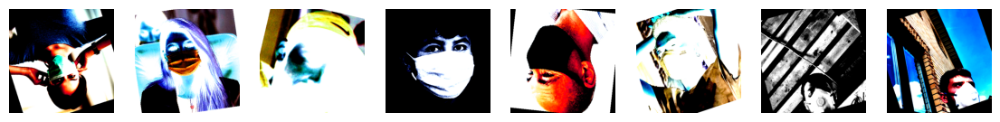

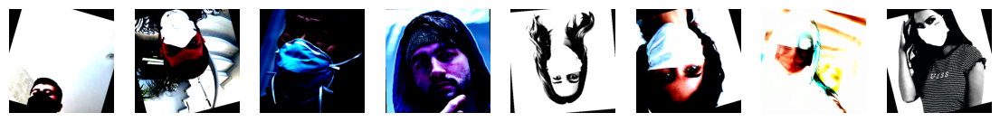

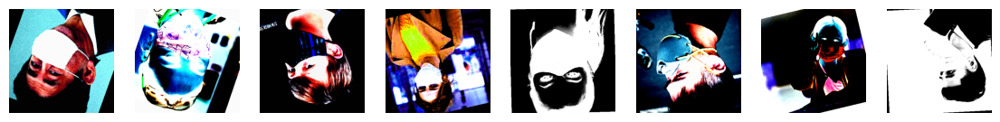

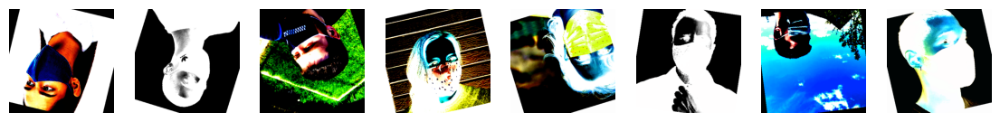

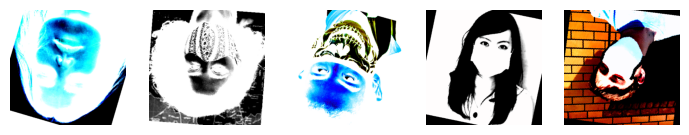

Epoch 2 of 20
Training set: Average loss: 3.5296, Accuracy: 284/308 (92%)

Validation set: Average loss: 1.2284, Accuracy: 87/88 (99%)

Liste des images non validées en phase d'entraînement :


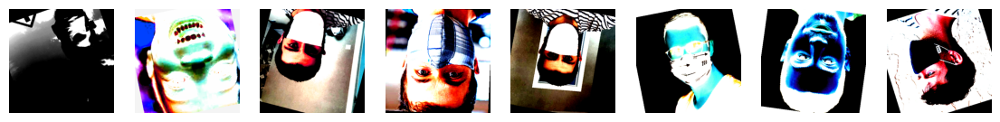

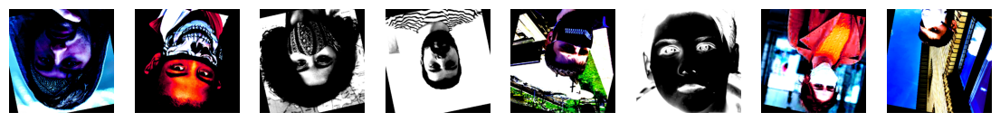

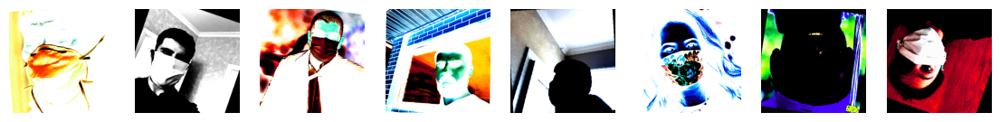

Epoch 3 of 20
Training set: Average loss: 3.1535, Accuracy: 290/308 (94%)

Validation set: Average loss: 1.0971, Accuracy: 87/88 (99%)

Liste des images non validées en phase d'entraînement :


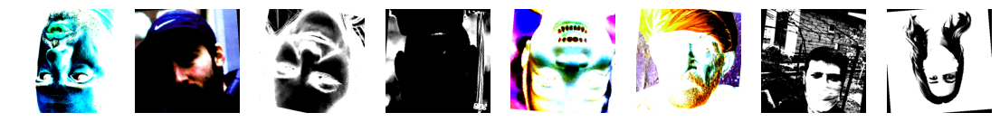

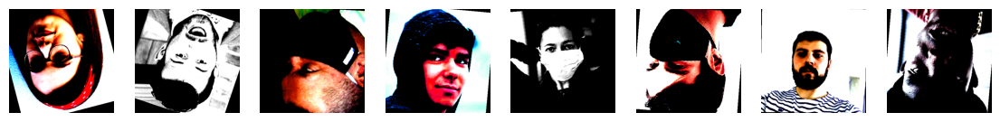

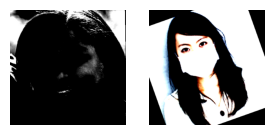

Epoch 4 of 20
Training set: Average loss: 2.5092, Accuracy: 294/308 (95%)

Validation set: Average loss: 0.7906, Accuracy: 87/88 (99%)

Liste des images non validées en phase d'entraînement :


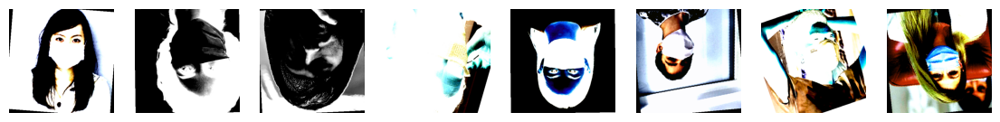

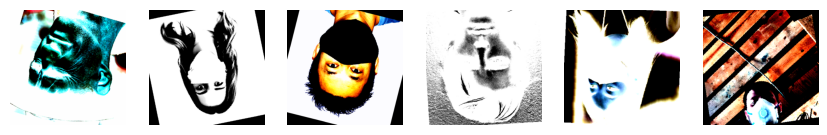

Epoch 5 of 20
Training set: Average loss: 2.7772, Accuracy: 288/308 (94%)

Validation set: Average loss: 0.7778, Accuracy: 86/88 (98%)

Liste des images non validées en phase d'entraînement :


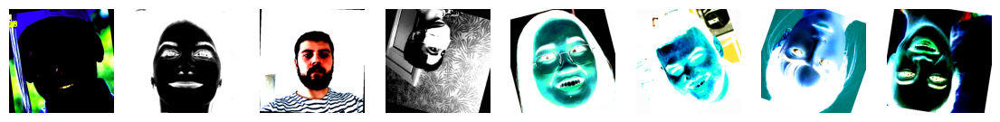

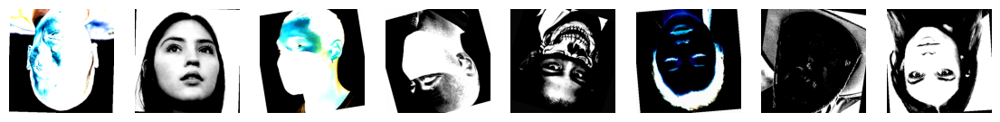

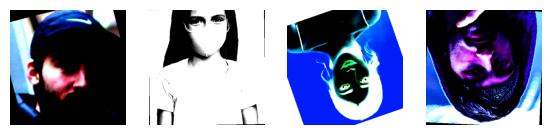

Epoch 6 of 20
Training set: Average loss: 2.0895, Accuracy: 296/308 (96%)

Validation set: Average loss: 0.7737, Accuracy: 87/88 (99%)

Liste des images non validées en phase d'entraînement :


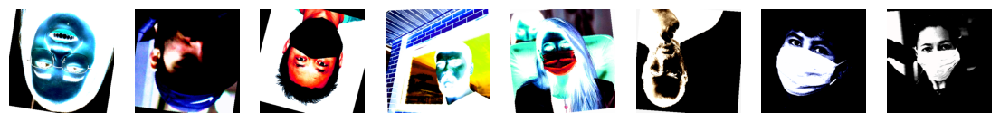

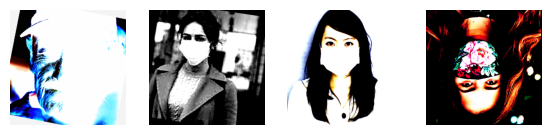

Early stopping : epoch 6
CPU times: user 5min 48s, sys: 4.07 s, total: 5min 52s
Wall time: 5min 53s


In [29]:
%%time
epochs = 20

loss_training, acc_training = [], []
loss_validation, acc_validation = [], []
patience = 5 #  Nombre d'epochs, avant de stopper le script, pendant lesquelles la loss_validation ne progresse plus
best_accuracy = -1.0
best_epoch = -1
num_epochs = 0

for epoch in range(1, epochs + 1):

    print(f"Epoch {epoch} of {epochs}")
    train(vit_model, optimizer)

    error_list = validate(vit_model, train_loader, loss_training, acc_training, "Training")
    validate(vit_model, validation_loader, loss_validation, acc_validation, "Validation")

    # Affichons sur chaque epochs les erreurs de prédiction lors de la phase d'entraînement du modèle
    print("Liste des images non validées en phase d'entraînement :")
    for e in range(len(error_list)):
          if e % 8 == 0:
            plt.figure(figsize=(14, 2))
          plt.subplot(1, 8, e % 8 + 1)
          plt.axis('off')
          image = error_list[e]
          image = np.transpose(image, (1, 2, 0))
          image = (image - image.min()) / (image.max() - image.min())
          plt.imshow(image)

          if (e + 1) % 8 == 0 or e == len(error_list) - 1:
            plt.show()

    if acc_validation[epoch - 1].item() > best_accuracy:
        best_accuracy = acc_validation[epoch - 1].item()
        best_epoch = epoch

        checkpoint = {
                'epoch': best_epoch,
                'model_state_dict': vit_model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'loss': loss_validation[best_epoch - 1],
                }

        early_stopping(checkpoint, "best_model1.pt")
    elif epoch - best_epoch >= patience:
        print("Early stopping : epoch %d" % epoch)
        num_epochs = epoch
        break

In [30]:
checkpoint = torch.load("best_model1.pt")
print(f"Meilleure itération retenue : {checkpoint['epoch']}")
print("Average loss sur l'étape de validation: {:.4f}".format(checkpoint['loss']))

Meilleure itération retenue : 1
Average loss sur l'étape de validation: 2.1690


### <font color='#3b4859'>3.3.2 Évaluation</font>

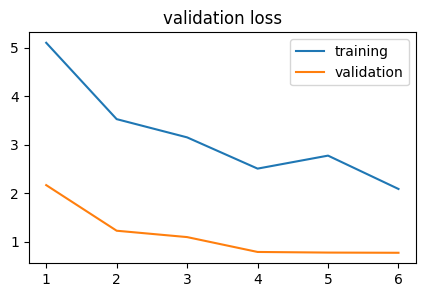

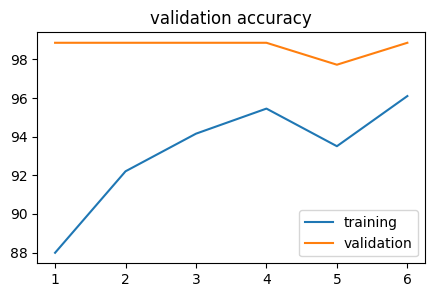

In [31]:
#@title Courbes d'évaluation ViT
plt.figure(figsize=(5,3))
plt.plot(np.arange(1,num_epochs + 1), loss_training)
plt.plot(np.arange(1,num_epochs + 1), loss_validation)
plt.legend(['training','validation'])
plt.title('validation loss')

plt.figure(figsize=(5,3))
plt.plot(np.arange(1,num_epochs + 1), acc_training)
plt.plot(np.arange(1,num_epochs + 1), acc_validation)
plt.legend(['training','validation'])
plt.title('validation accuracy');

Nous observons que le modèle est très proche des données d'entraînement. Les prédictions sont très bonnes sur l'échantillon d'entraînement et de validation. Il s'agit ici d'un phénomène de surapprentissage. La raison provient certainement du faible nombre de données et une data augmentation qui ne différentie pas suffisament les images entre l'étape de train et celle de validation.

## <font color='#3b4859'>3.4 Prédiction sur l'échantillon de test</font>

Test set: Average loss: 1.9267, Accuracy: 43/44 (98%)



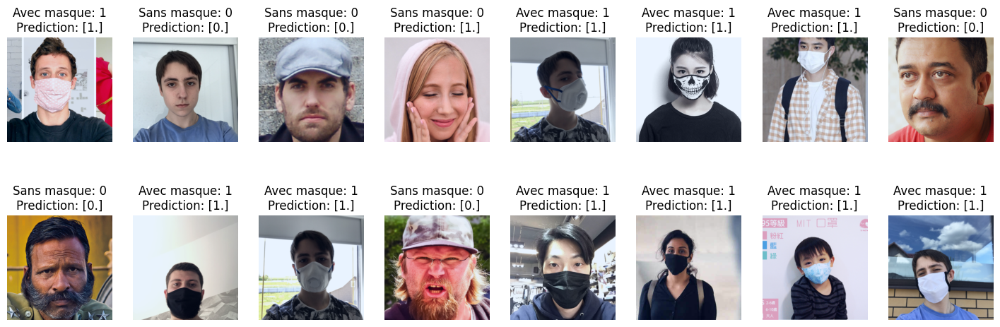

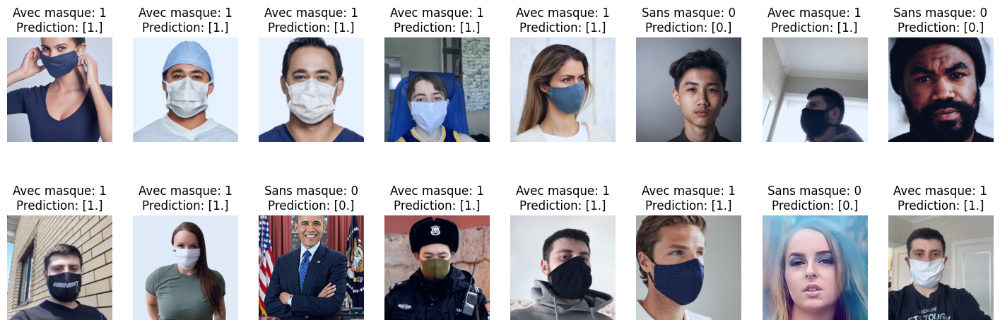

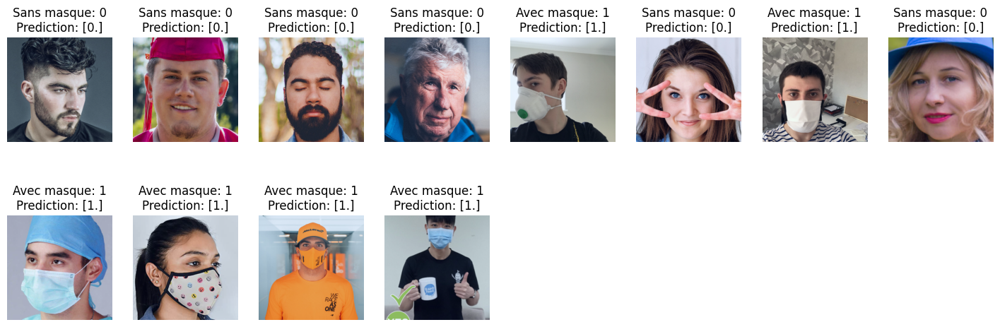

In [32]:
checkpoint = torch.load("best_model1.pt")
vit_model.load_state_dict(checkpoint['model_state_dict'])
optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']
loss = checkpoint['loss']
error_list = validate(vit_model, test_loader, loss_validation, acc_validation, "Test")



---



---


Passons maintenant à l'entraînement du modèle RegNet.

In [33]:
num_features = regnet_model.fc.in_features

for param in regnet_model.parameters():
    param.requires_grad = False

# Modifions la dernière couche fully connected
regnet_model.fc = nn.Linear(num_features, 1, bias=True)
regnet_model = regnet_model.to(device)

param_entrainables = sum(p.numel() for p in regnet_model.parameters() if p.requires_grad)
print(f"Le modèle a {param_entrainables} paramètres entraînables")

optimizer = torch.optim.Adam(regnet_model.parameters(), weight_decay=0.1)

Le modèle a 3713 paramètres entraînables


Epoch 1 of 20
Training set: Average loss: 5.3020, Accuracy: 261/308 (85%)

Validation set: Average loss: 16.2635, Accuracy: 49/88 (56%)

Liste des images non validées en phase d'entraînement :


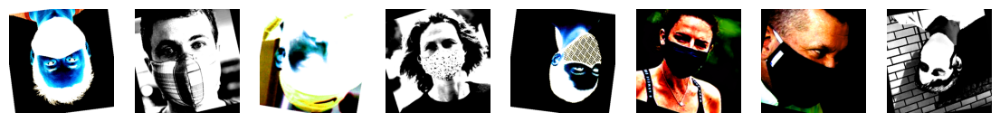

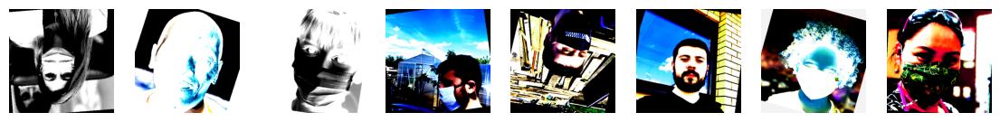

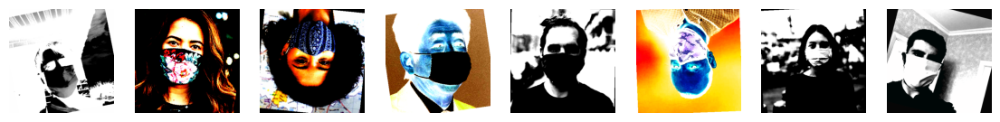

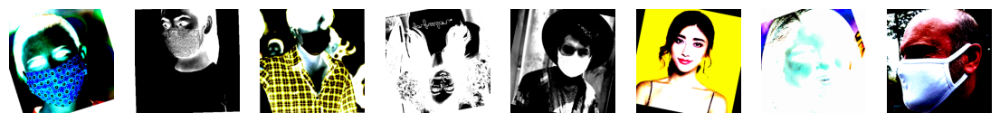

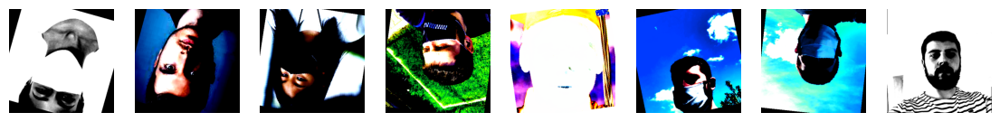

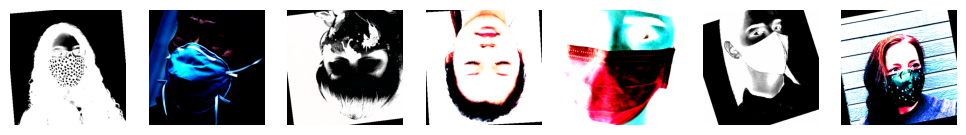

Epoch 2 of 20
Training set: Average loss: 4.3688, Accuracy: 269/308 (87%)

Validation set: Average loss: 721.2899, Accuracy: 43/88 (49%)

Liste des images non validées en phase d'entraînement :


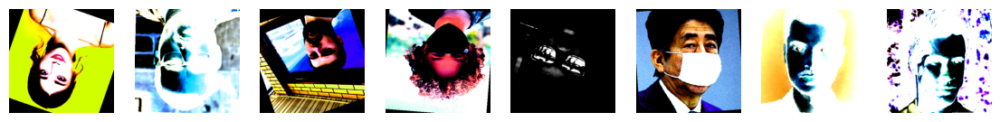

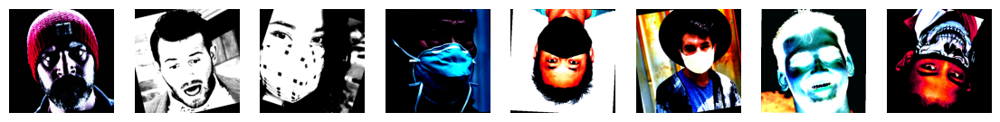

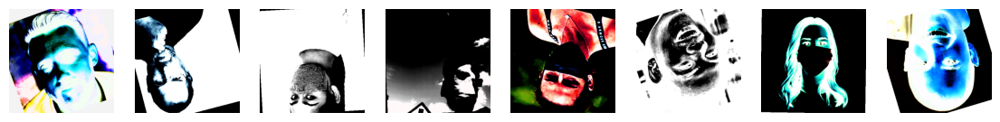

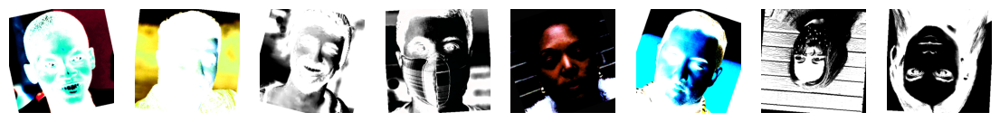

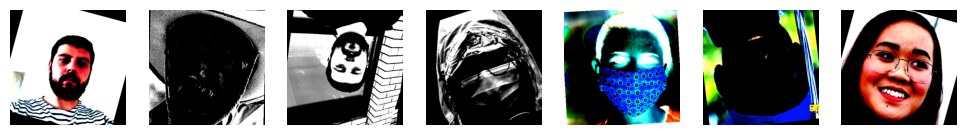

Epoch 3 of 20
Training set: Average loss: 3.7727, Accuracy: 280/308 (91%)

Validation set: Average loss: 1232.8523, Accuracy: 43/88 (49%)

Liste des images non validées en phase d'entraînement :


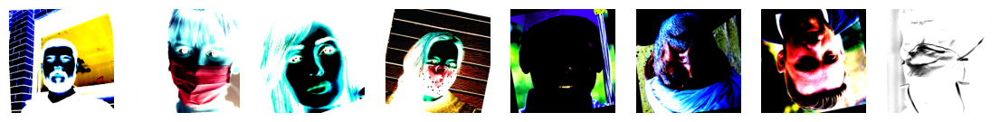

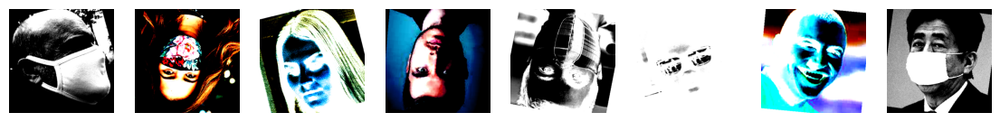

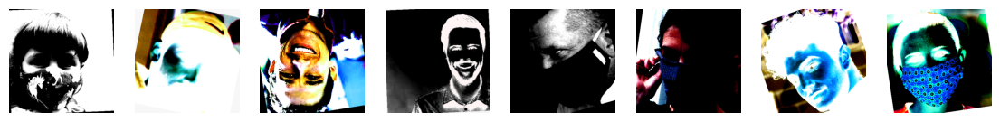

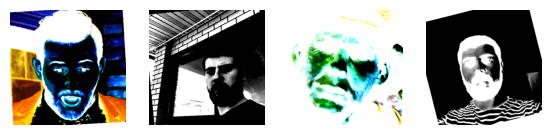

Epoch 4 of 20
Training set: Average loss: 3.2585, Accuracy: 287/308 (93%)

Validation set: Average loss: 1541.6467, Accuracy: 43/88 (49%)

Liste des images non validées en phase d'entraînement :


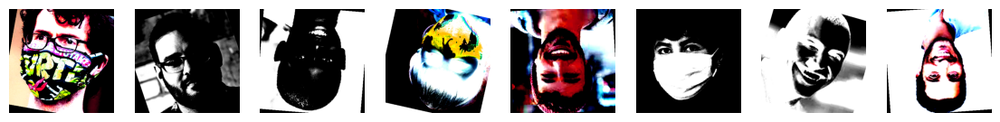

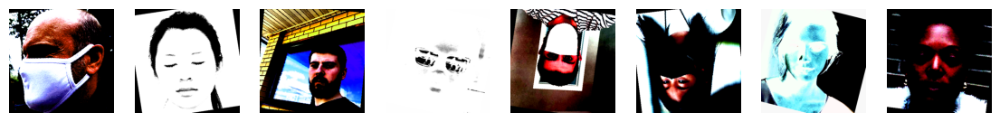

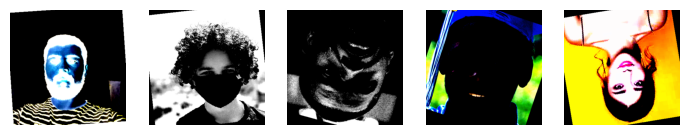

Epoch 5 of 20
Training set: Average loss: 3.0017, Accuracy: 289/308 (94%)

Validation set: Average loss: 2063.3519, Accuracy: 43/88 (49%)

Liste des images non validées en phase d'entraînement :


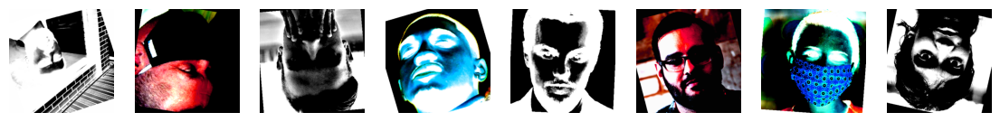

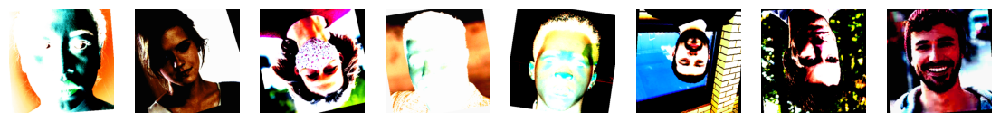

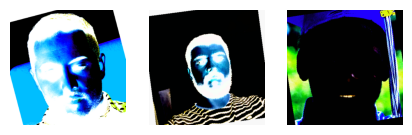

Epoch 6 of 20
Training set: Average loss: 3.5264, Accuracy: 280/308 (91%)

Validation set: Average loss: 2359.2568, Accuracy: 44/88 (50%)

Liste des images non validées en phase d'entraînement :


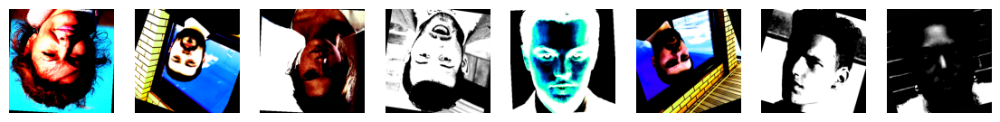

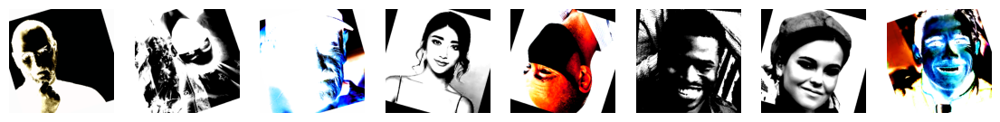

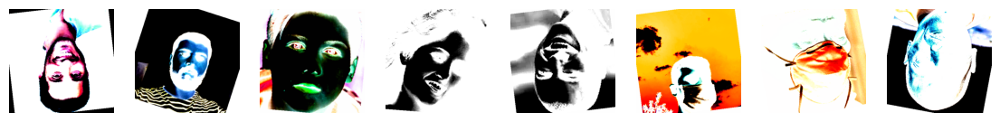

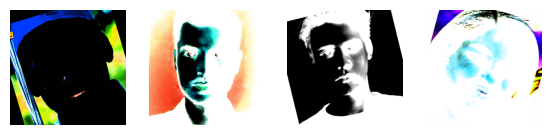

Early stopping : epoch 6
CPU times: user 7min 2s, sys: 3.88 s, total: 7min 6s
Wall time: 7min 5s


In [34]:
%%time
epochs = 20
num_epochs = 0

loss_training, acc_training = [], []
loss_validation, acc_validation = [], []

for epoch in range(1, epochs + 1):
    print(f"Epoch {epoch} of {epochs}")
    train(regnet_model, optimizer)

    error_list = validate(regnet_model, train_loader, loss_training, acc_training, "Training")
    validate(regnet_model, validation_loader, loss_validation, acc_validation, "Validation")

# Affichons sur chaque epochs les erreurs de prédiction lors de la phase d'entraînement du modèle
    print("Liste des images non validées en phase d'entraînement :")
    for e in range(len(error_list)):
          if e % 8 == 0:
            plt.figure(figsize=(14, 2))
          plt.subplot(1, 8, e % 8 + 1)
          plt.axis('off')
          image = error_list[e]
          image = np.transpose(image, (1, 2, 0))
          image = (image - image.min()) / (image.max() - image.min())
          plt.imshow(image)

          if (e + 1) % 8 == 0 or e == len(error_list) - 1:
            plt.show()

    if acc_validation[epoch - 1].item() > best_accuracy:
        best_accuracy = acc_validation[epoch - 1].item()
        best_epoch = epoch

        checkpoint = {
                'epoch': best_epoch,
                'model_state_dict': regnet_model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'loss': loss_validation[best_epoch - 1],
                }

        early_stopping(checkpoint, "regnet_best_model.pt")
    elif epoch - best_epoch >= patience:
        print("Early stopping : epoch %d" % epoch)
        num_epochs = epoch
        break

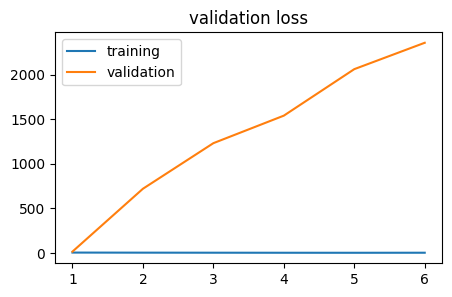

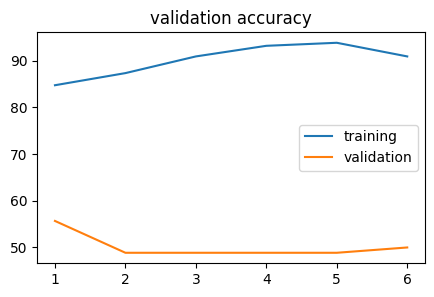

In [35]:
#@title Courbes d'évaluation RegNet
plt.figure(figsize=(5,3))
plt.plot(np.arange(1,num_epochs + 1), loss_training)
plt.plot(np.arange(1,num_epochs + 1), loss_validation)
plt.legend(['training','validation'])
plt.title('validation loss')

plt.figure(figsize=(5,3))
plt.plot(np.arange(1,num_epochs + 1), acc_training)
plt.plot(np.arange(1,num_epochs + 1), acc_validation)
plt.legend(['training','validation'])
plt.title('validation accuracy');

Nous observons sur ce modèle une valeur de la loss très élevée sur l'échantillon de validation. Le modèle est en sur-apprentissage, il n'arrive pas à généraliser sur de nouvelles données. Ceci peut s'expliquer par une taille de jeu de donnée d'entraînement trop petite, une data-augmentation qui ne diversifie pas suffisament les données en entrée. Aussi nous pouvons noter la complexité du modèle et un apprentissage trop important sur les données d'entraînement.

Test set: Average loss: 3166.7643, Accuracy: 28/44 (64%)



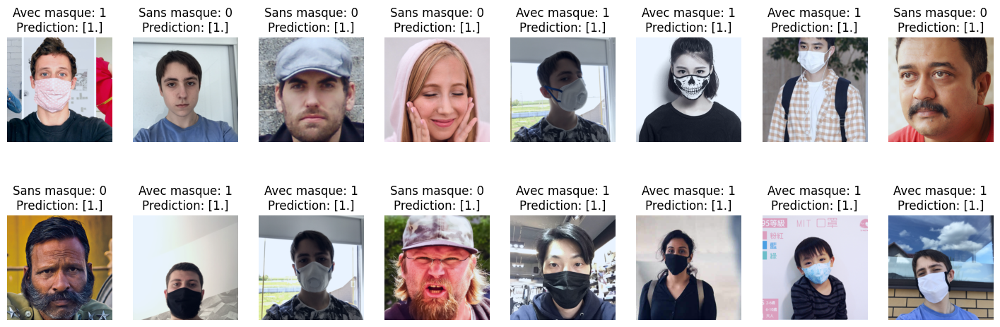

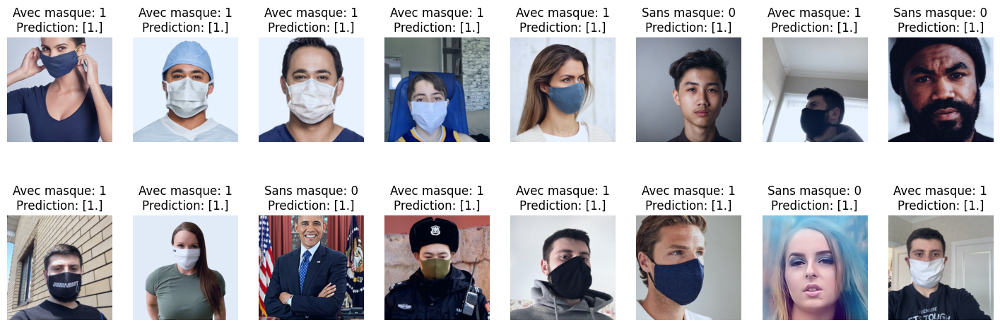

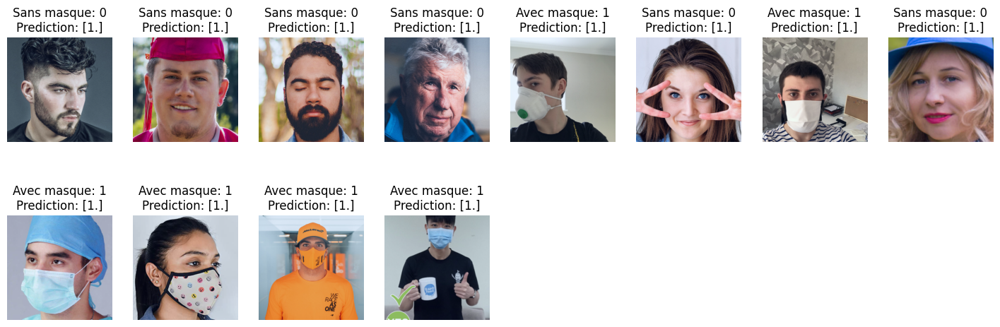

In [36]:
error_list = validate(regnet_model, test_loader, loss_validation, acc_validation, "Test")


## <font color='#3b4859'>3.5 Gestion des hyperparamètres</font>

La data augmentation mise en place précédement d'une manière personnalisée n'a pas correctement limité le risque de sur-apprentissage.

Dans cette partie nous allons utiliser une méthode d'auto-augmentation présente dans la librairie de pytorch.

Nous en analyserons les effets sur les performances du modèle de vision transformer.

In [37]:
# Modifions la data augmentation
data_augmentation = T.Compose([
    transforms.Resize(384, InterpolationMode.BICUBIC),
    transforms.CenterCrop(384),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    transforms.Lambda(lambda x: x.to(torch.uint8)),
    # méthode d'auto-augmentation
    transforms.TrivialAugmentWide(),
    transforms.Lambda(lambda x: x.float()),
])

Nous devons réinitialiser les données et l'optimizer.

In [38]:
# Les datasets
train_dataset = ImageDataset(img_dir=train_paths, transform=data_augmentation)
test_dataset = ImageDataset(img_dir=test_paths, transform=data_transform)

In [39]:
# Ensuite divisons l'échantillon de test
full_size = len(train_dataset) + len(test_dataset)
val_size = int(0.2 * full_size)
test_size = len(test_dataset) - (val_size)
validation_dataset, test_dataset = torch.utils.data.random_split(test_dataset, (val_size, test_size))

print(f"La taille de l'échantillon de validation est de {len(validation_dataset)} images.")
print(f"La taille de celui de test est de {len(test_dataset)} images.")

La taille de l'échantillon de validation est de 88 images.
La taille de celui de test est de 44 images.


In [40]:
batch_size = 16

# Création des DataLoader de training et validation
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
validation_loader  = torch.utils.data.DataLoader(validation_dataset, batch_size=batch_size, shuffle=False, num_workers=0)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=0)

In [41]:
# Réinitialiser l'optimizier
optimizer = torch.optim.Adam(vit_model.parameters(), weight_decay=0.1)

Epoch 1 of 20
Training set: Average loss: 9.0275, Accuracy: 212/308 (69%)

Validation set: Average loss: 2.4664, Accuracy: 85/88 (97%)

Liste des images non validées en phase d'entraînement :


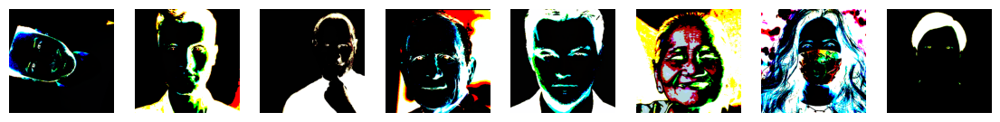

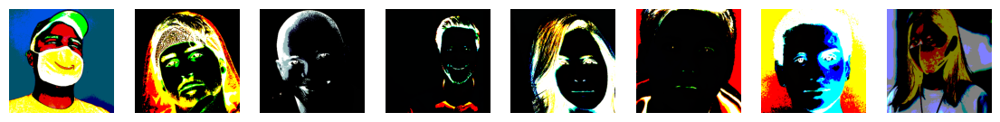

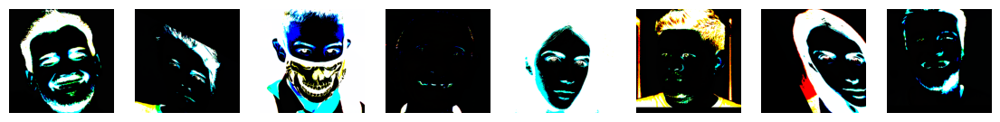

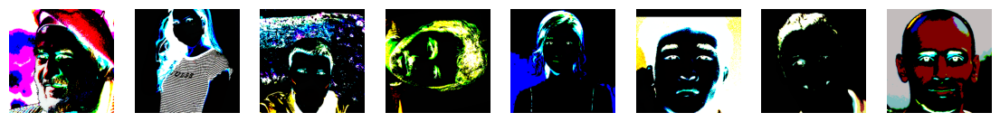

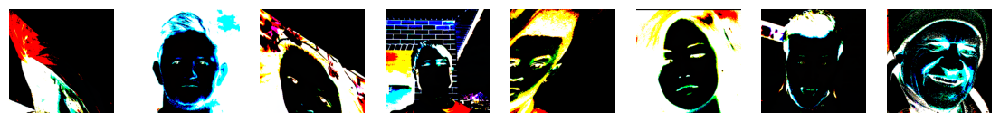

...

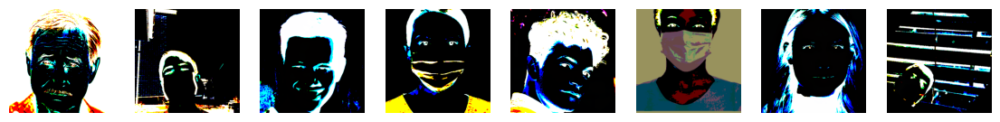

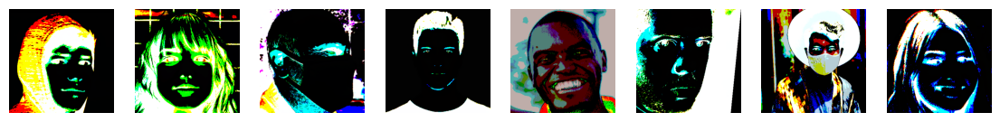

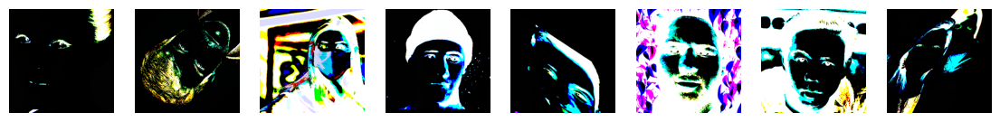

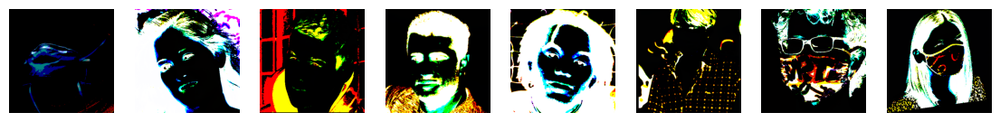

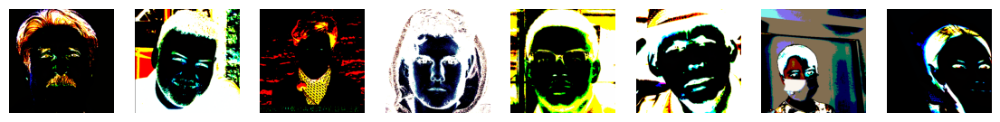

Epoch 2 of 20
Training set: Average loss: 8.7176, Accuracy: 222/308 (72%)

Validation set: Average loss: 2.0573, Accuracy: 86/88 (98%)

Liste des images non validées en phase d'entraînement :


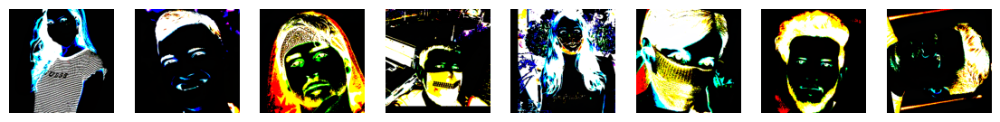

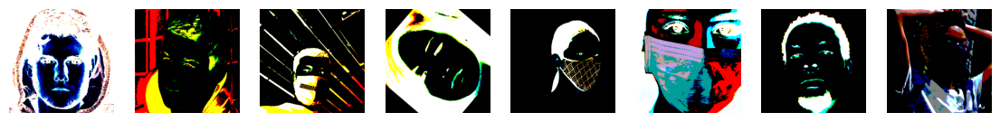

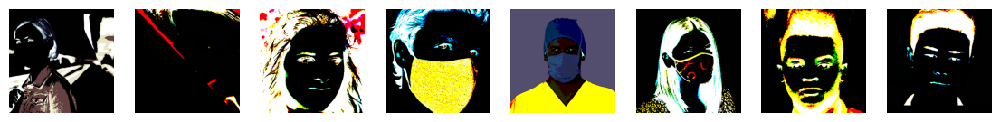

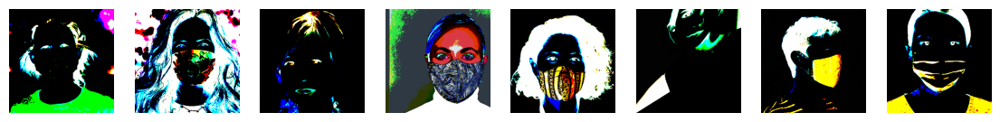

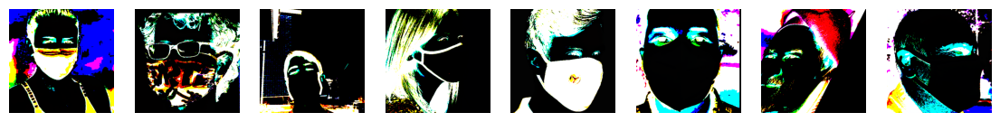

...

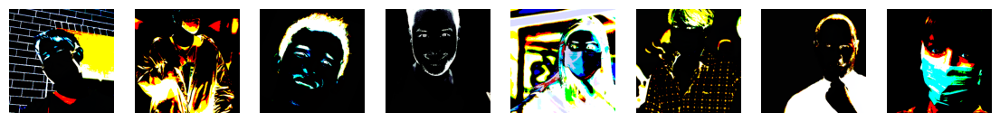

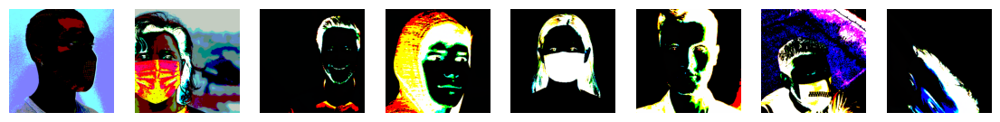

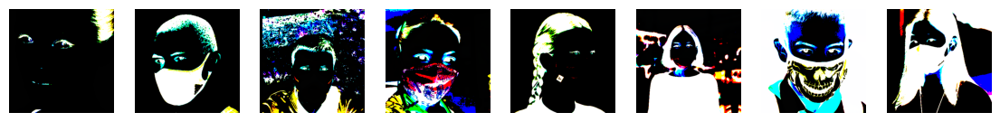

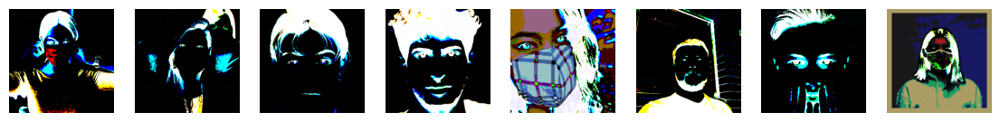

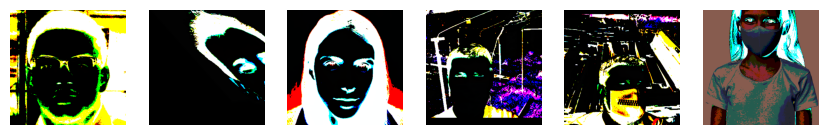

Epoch 3 of 20
Training set: Average loss: 8.3219, Accuracy: 228/308 (74%)

Validation set: Average loss: 1.8418, Accuracy: 86/88 (98%)

Liste des images non validées en phase d'entraînement :


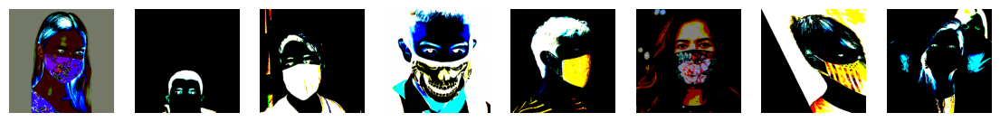

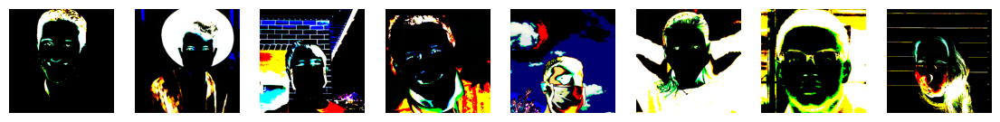

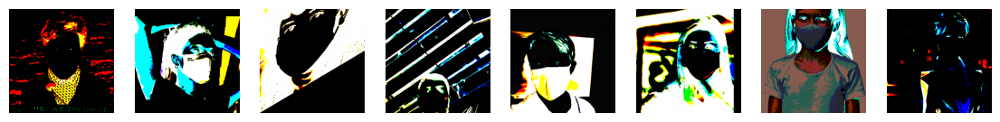

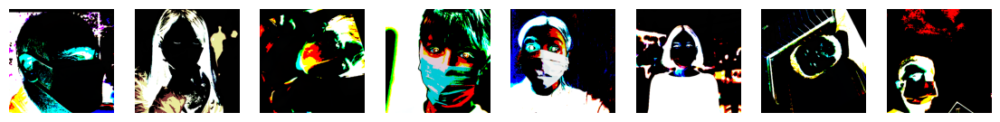

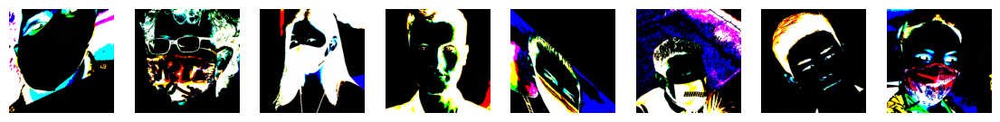

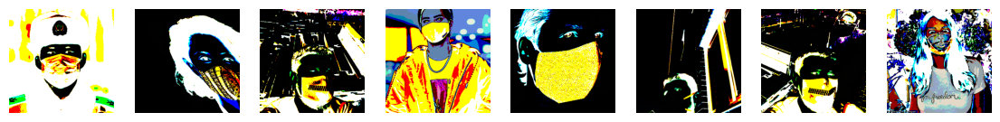

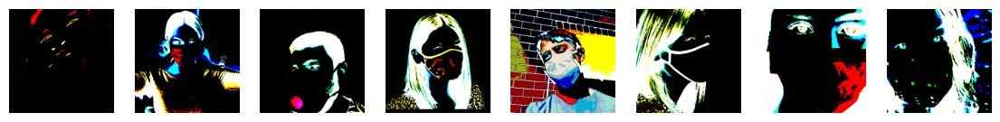

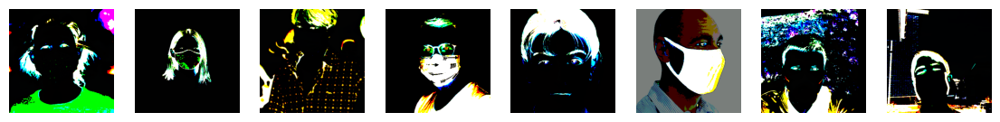

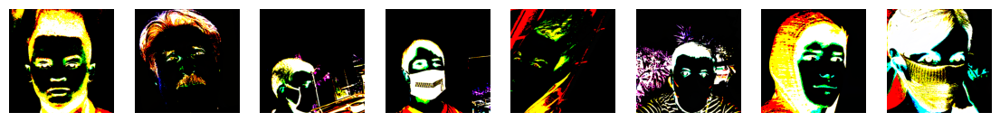

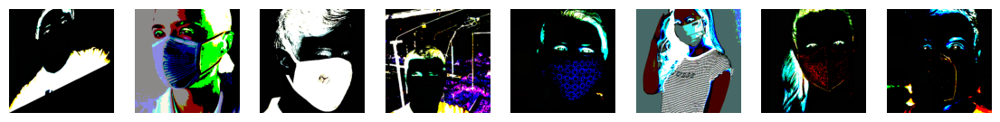

Epoch 4 of 20
Training set: Average loss: 9.3172, Accuracy: 200/308 (65%)

Validation set: Average loss: 1.6808, Accuracy: 86/88 (98%)

Liste des images non validées en phase d'entraînement :


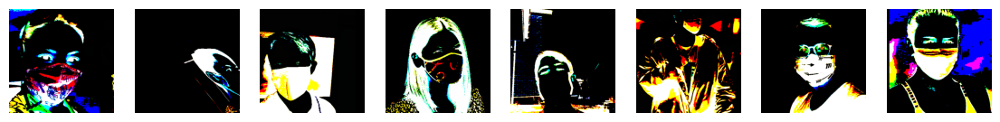

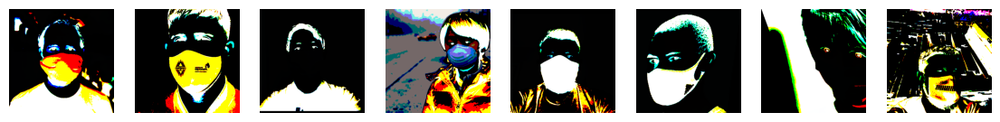

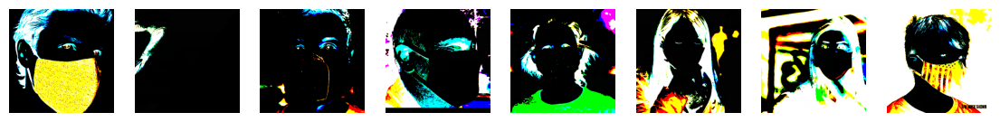

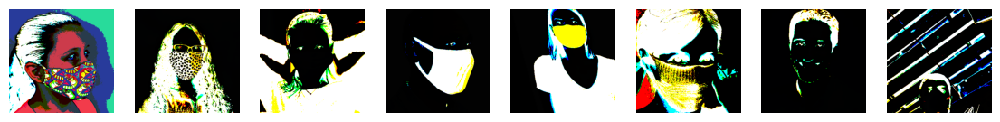

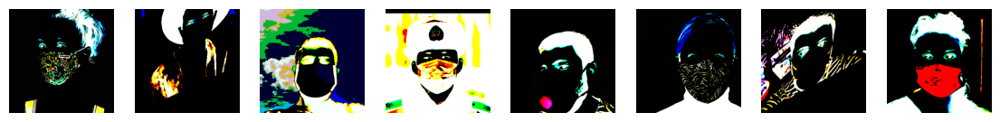

...

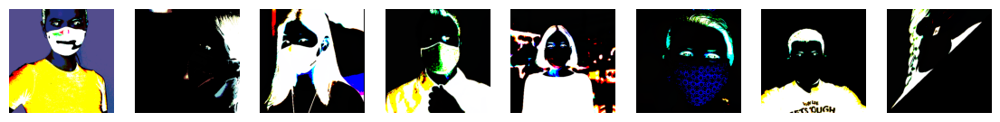

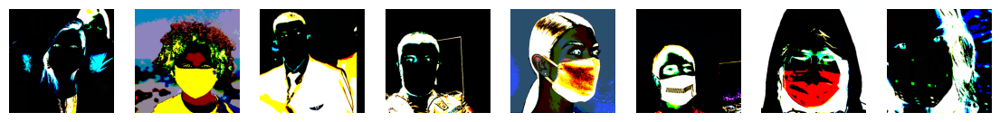

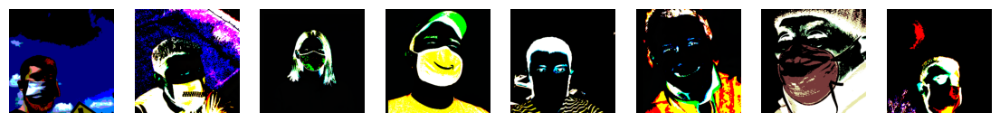

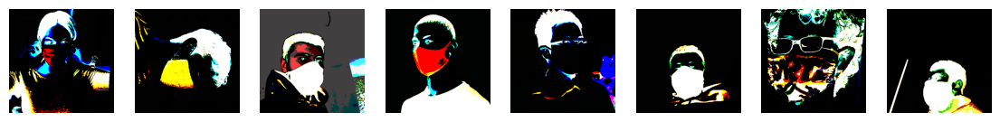

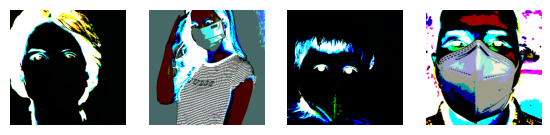

Epoch 5 of 20
Training set: Average loss: 8.1326, Accuracy: 227/308 (74%)

Validation set: Average loss: 1.7371, Accuracy: 86/88 (98%)

Liste des images non validées en phase d'entraînement :


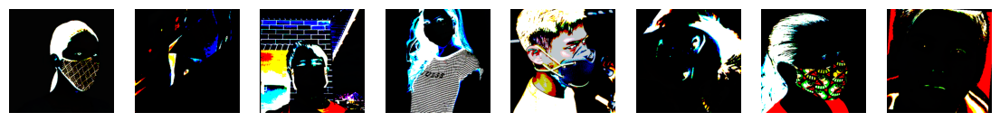

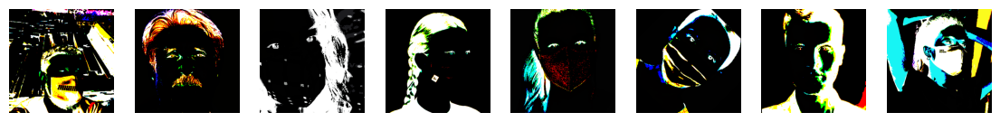

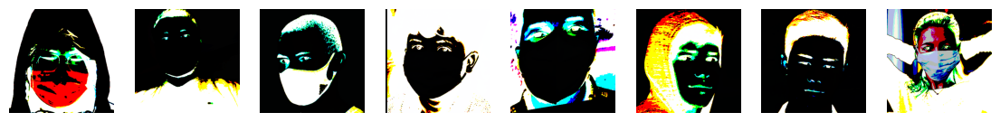

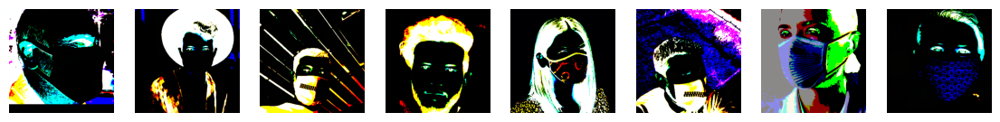

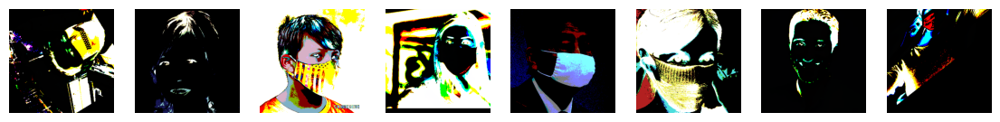

...

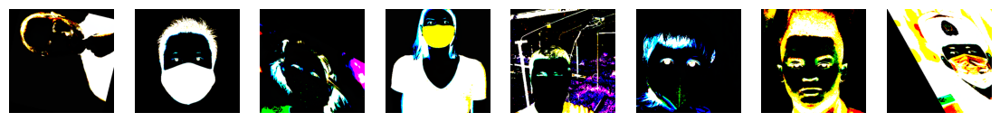

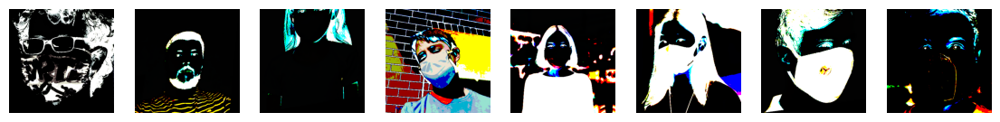

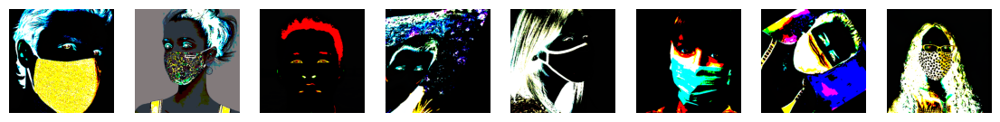

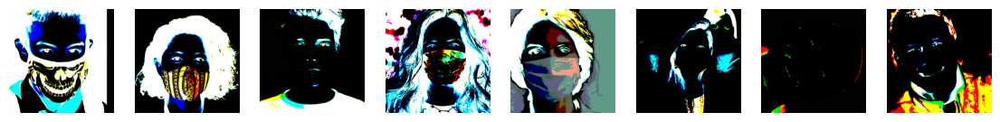

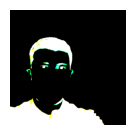

Epoch 6 of 20
Training set: Average loss: 8.1653, Accuracy: 229/308 (74%)

Validation set: Average loss: 1.6940, Accuracy: 86/88 (98%)

Liste des images non validées en phase d'entraînement :


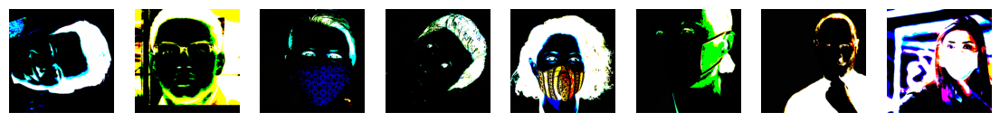

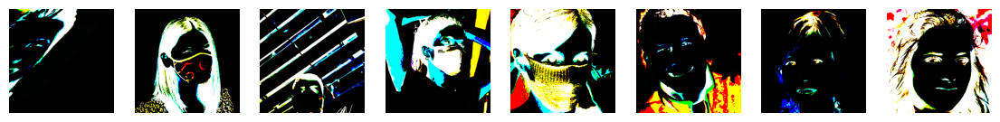

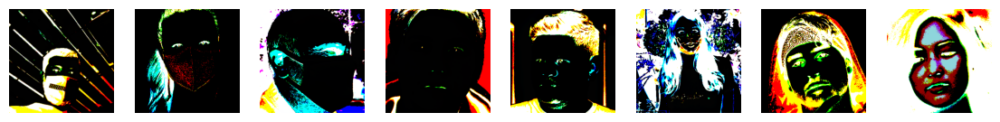

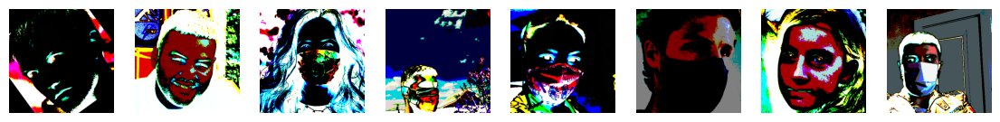

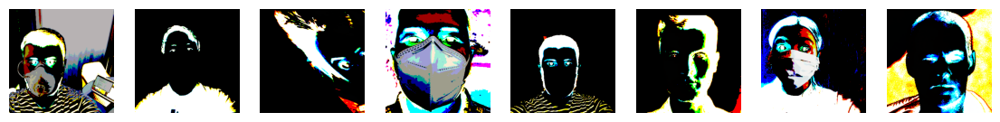

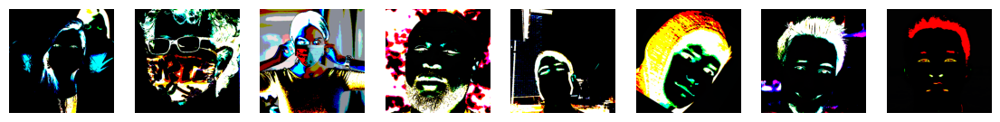

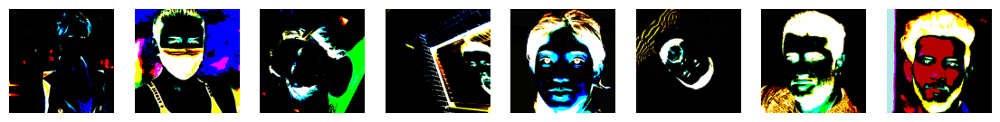

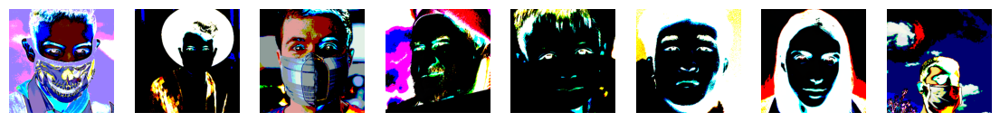

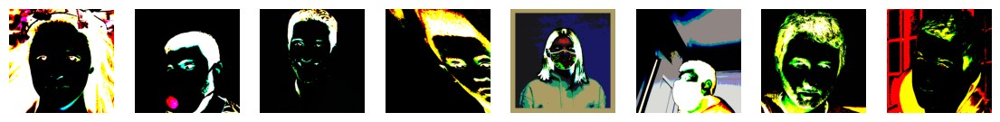

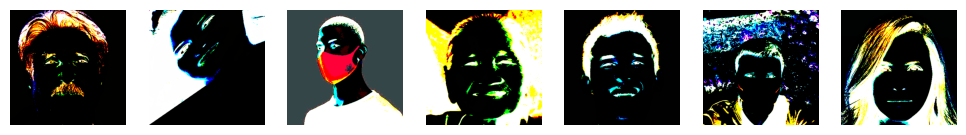

Epoch 7 of 20
Training set: Average loss: 7.8838, Accuracy: 234/308 (76%)

Validation set: Average loss: 1.6449, Accuracy: 85/88 (97%)

Liste des images non validées en phase d'entraînement :


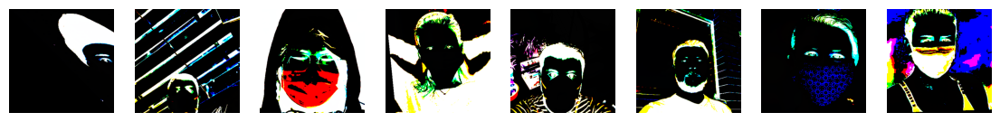

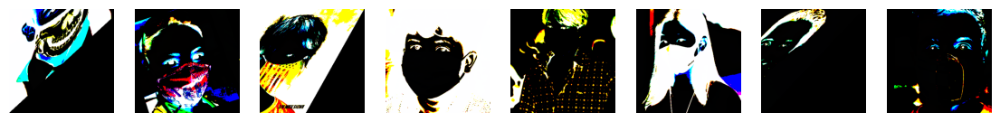

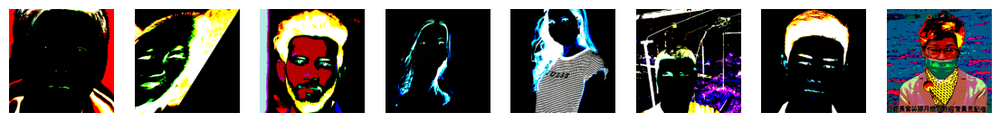

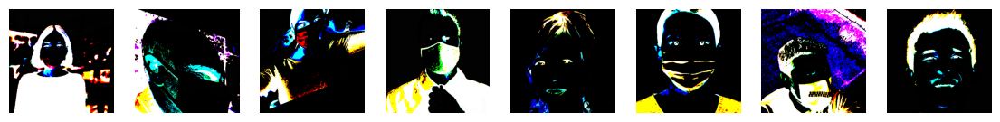

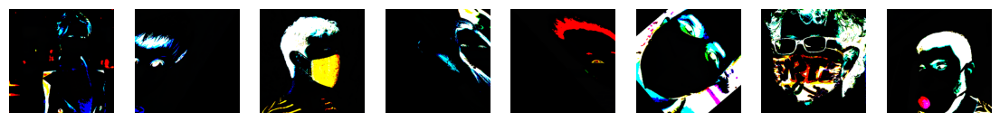

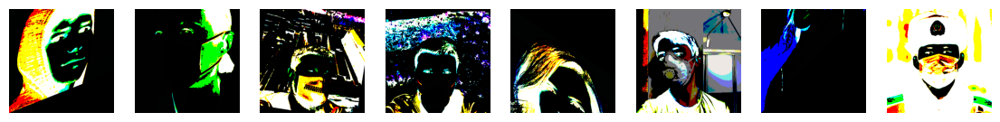

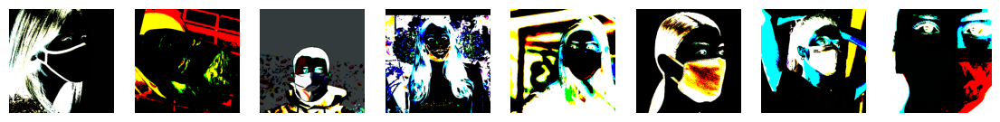

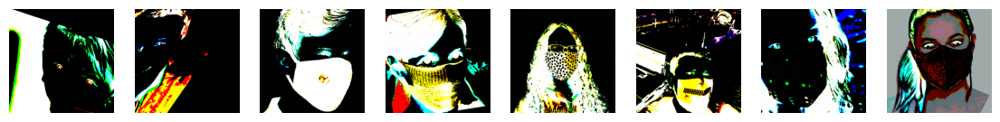

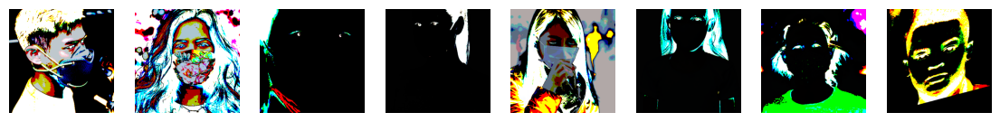

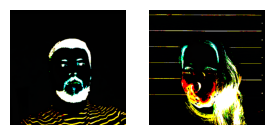

Early stopping : epoch 7
CPU times: user 4min 35s, sys: 9.59 s, total: 4min 45s
Wall time: 4min 41s


In [42]:
%%time
epochs = 20

loss_training, acc_training = [], []
loss_validation, acc_validation = [], []
patience = 5 #  Nombre d'epochs, avant de stopper le script, pendant lesquelles la loss_validation ne progresse plus
best_accuracy = -1.0
best_epoch = -1
num_epochs = 0

for epoch in range(1, epochs + 1):

    print(f"Epoch {epoch} of {epochs}")
    train(vit_model, optimizer)

    error_list = validate(vit_model, train_loader, loss_training, acc_training, "Training")
    validate(vit_model, validation_loader, loss_validation, acc_validation, "Validation")

    # Affichons sur chaque epochs les erreurs de prédiction lors de la phase d'entraînement du modèle
    print("Liste des images non validées en phase d'entraînement :")
    for e in range(len(error_list)):
          if e % 8 == 0:
            plt.figure(figsize=(14, 2))
          plt.subplot(1, 8, e % 8 + 1)
          plt.axis('off')
          image = error_list[e]
          image = np.transpose(image, (1, 2, 0))
          image = (image - image.min()) / (image.max() - image.min())
          plt.imshow(image)

          if (e + 1) % 8 == 0 or e == len(error_list) - 1:
            plt.show()

    if acc_validation[epoch - 1].item() > best_accuracy:
        best_accuracy = acc_validation[epoch - 1].item()
        best_epoch = epoch

        checkpoint = {
                'epoch': best_epoch,
                'model_state_dict': vit_model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'loss': loss_validation[best_epoch - 1],
                }

        early_stopping(checkpoint, "best_model.pt")
    elif epoch - best_epoch >= patience:
        print("Early stopping : epoch %d" % epoch)
        num_epochs = epoch
        break

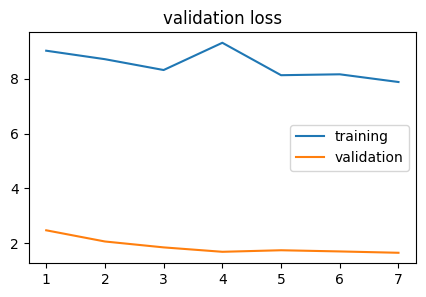

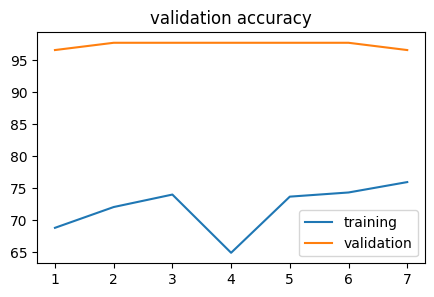

In [43]:
#@title Courbes d'évaluation ViT avec AutoAugment
plt.figure(figsize=(5,3))
plt.plot(np.arange(1,num_epochs + 1), loss_training)
plt.plot(np.arange(1,num_epochs + 1), loss_validation)
plt.legend(['training','validation'])
plt.title('validation loss')

plt.figure(figsize=(5,3))
plt.plot(np.arange(1,num_epochs + 1), acc_training)
plt.plot(np.arange(1,num_epochs + 1), acc_validation)
plt.legend(['training','validation'])
plt.title('validation accuracy');

La modification d'hyper-paramètres telle que la data-augmentation rend le modèle plus robuste au sur-apprentissage.

Nous observons une progression des résultats sur la capacité du modèle a correctement identifier les images pendant la phase d'entraînement et les performances sur les nouvelles données sont bonnes.

La data augmentation réalisée par autoAugment semble ajouter des transformations et des biais qui rendent l'analyse de certaines images difficiles. Ceci améliore l'apprentissage du modèle mais augmente aussi les biais déjà présents.


Test set: Average loss: 1.9761, Accuracy: 43/44 (98%)



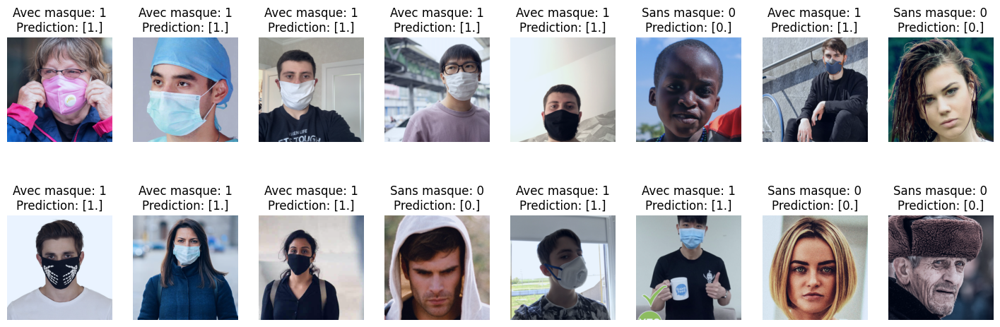

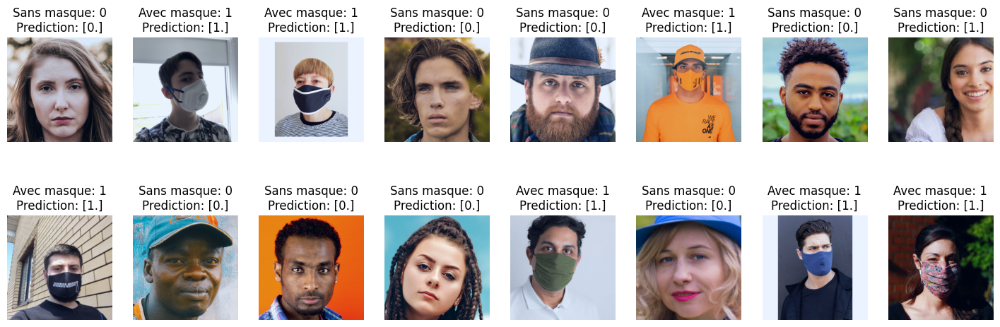

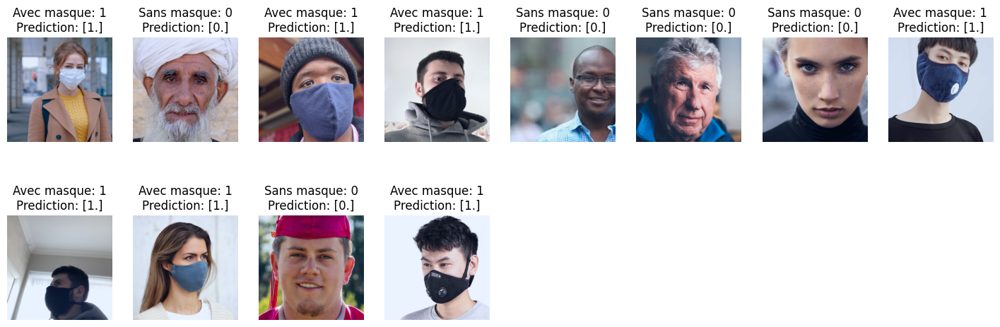

In [44]:
checkpoint = torch.load("best_model.pt")
vit_model.load_state_dict(checkpoint['model_state_dict'])
optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']
loss = checkpoint['loss']
error_list = validate(vit_model, test_loader, loss_validation, acc_validation, "Test")

En conclusion, la complexité du modèle de vision transformer le rend très performant sur la reconnaissance d'images. Cependant, l'apprentissage est exigent, il nécessite un jeu de donnée diversifié et une gestion des hyper-paramètres appropriée.